author: Martynas Lukoševičius


The task is to analyse data and create a model which would predict if item will be sold in 24 hours. Dataset contains 76 features from which 27 are categorical and 36 continuous. Target proportions are not equal. For feature evaluation chi2 and anova tests were conducted. Data analysis shown that most important features are cities, brands, catalog_codes, window_item_sold, total_negative_feadback_count, birthday and phone_verification_local_time. However, on PCA projections no visible decision boundary is visible, making classification task hard.

Few machine learning models were trained: logistic regression, SVM, gradient boosting classifier and KNN. Gradient boosting classifier yielded best score = ~70%. 

Imports 

In [1]:
import os
import warnings
import pandas as pd 
import numpy as np 
import re
import dill as pickle
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import plotly.io as pio
pio.renderers.default='notebook'

from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.preprocessing import LabelBinarizer, MultiLabelBinarizer, FunctionTransformer, OneHotEncoder, StandardScaler, RobustScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import train_test_split as tts, ParameterGrid, cross_val_score 
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, plot_confusion_matrix, roc_curve, roc_auc_score
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier, RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier

reading data 

In [2]:
data_raw = pd.read_parquet("data.parquet", engine = "pyarrow")
test_raw = pd.read_parquet("test.parquet", engine = "pyarrow")
example_pred = pd.read_parquet("example_predictions.parquet", engine = "pyarrow")

# Data analysis 

Data inspection 

In [3]:
data_raw.head()

,portal,brand,brand_is_verified,catalog_code_1,catalog_code_2,catalog_code_3,catalog_code_4,catalog_code_5,color_primary,color_secondary,...,window_items_listed,window_items_sold,acquisition_type,got_voucher,paid_organic,registration_app_id,registration_full_utm,registration_local_time,registration_platform,registration_type
0,us,Victoria's Secret,None,WOMEN_ROOT,WOMENS,TOPS_T_SHIRTS,WOM_TOP_T_SHIRTS,None,GREEN,WHITE,...,142,3,organic,Member without voucher,organic,2.0,Unknown,2015-03-31T19:42:47.000-07:00,iphone,Unknown
1,us,Pink,None,WOMEN_ROOT,WOMENS,TOPS_T_SHIRTS,SHIRTS,None,BLUE,WHITE,...,3,0,organic,Member without voucher,organic,2.0,Unknown,2017-04-03T19:19:53.000-07:00,iphone,Email
2,us,,None,BUNDLES,None,None,None,None,BLACK,VARIOUS,...,21,0,organic,Member without voucher,organic,2.0,Unknown,2018-09-13T20:41:52.000-07:00,iphone,Facebook
3,us,van halen,None,WOMEN_ROOT,WOMENS,TOPS_T_SHIRTS,WOM_TOP_T_SHIRTS,None,GREY,None,...,477,13,voucher,Member with voucher,organic,2.0,Unknown,2014-04-03T22:45:33.000-07:00,iphone,Unknown
4,us,,None,WOMEN_ROOT,WOMENS,DRESSES,LITTLE_BLACK_DRESSES,None,BLACK,None,...,15,0,organic,Member without voucher,organic,1.0,Organic,2019-02-18T14:15:54.000-07:00,android,Email


## Feature types 

### Categorical 
portal,
brand,
brand_is_verified,
catalog_code_* ,
color_* ,
listing_platform,
package_size_code,
with_video,
city,
with_video,
country_code,
gender,
language,
state

size - needs preprocessing 

disposal_conditions(disposal_conditions_string) - keep one 

hashtags - change to if exist 

### Continuous 

listing_price_local,
days_since_app_install,
days_since_first_visit,
days_since_registration,
days_since_user_first_listing,
lister_nth_day_of_listing ,
lister_nth_listing,
total_items_sold,
total_feedback_count,
total_gmv_bought,
total_gmv_sold,
total_items_bought,
total_items_listed,
total_negative_feedback_count,
total_neutral_feedback_count,
total_positive_feedback_count,
window_gmv_bought,
window_gmv_sold,
window_items_bought,
window_items_listed,
window_items_sold,

#### Date/Time

local_time,
sale_time,
birthday,
basic_verification_local_time,
facebook_link_local_time,
first_app_install_local_time,
first_closet_promotion_local_time,
first_faq_entry_view_local_time,
first_listing_local_time,
first_paid_bump_local_time,
first_purchase_local_time,
first_reported_local_time,
first_reporting_local_time,
first_sale_local_time,
first_size_personalisation_local_time,
first_upload_form_visit_local_time,
first_wanted_item_local_time

title - not planning to do anything with it 

lifetime - not sure what it is 

checking types of data in dataframe

In [4]:
data_raw.dtypes

portal                      object
brand                       object
brand_is_verified           object
catalog_code_1              object
catalog_code_2              object
                            ...   
registration_app_id        float64
registration_full_utm       object
registration_local_time     object
registration_platform       object
registration_type           object
Length: 76, dtype: object

## generate target 

Check local_time and sale_time features

In [5]:
print(f"local time has {data_raw['local_time'].isna().sum()} missing values and sale_time has {data_raw['sale_time'].isna().sum()} missing values") 

local time has 0 missing values and sale_time has 556403 missing values


removing rows with na in sale_time, as missing values not necessarily mean that it was not sold 

In [6]:
data = data_raw[data_raw['sale_time'].notna()]

calculating target 

In [7]:
datetime_local_time = pd.to_datetime(data["local_time"],format="%Y-%m-%dT%H:%M:%S.%f%z")
datetime_sale_time = pd.to_datetime(data["sale_time"],format="%Y-%m-%dT%H:%M:%S.%f%z")
offset =  pd.DateOffset(hours=24)
target = datetime_sale_time <= (datetime_local_time + offset)

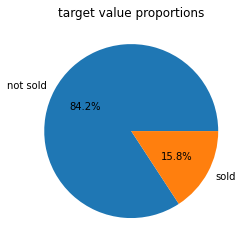

In [8]:
target_prop = dict(target.value_counts() * 100 / len(target))
plt.pie(target_prop.values(), labels = ["not sold", "sold",], autopct='%1.1f%%')
plt.title("target value proportions")
plt.show()

## missing data in features 

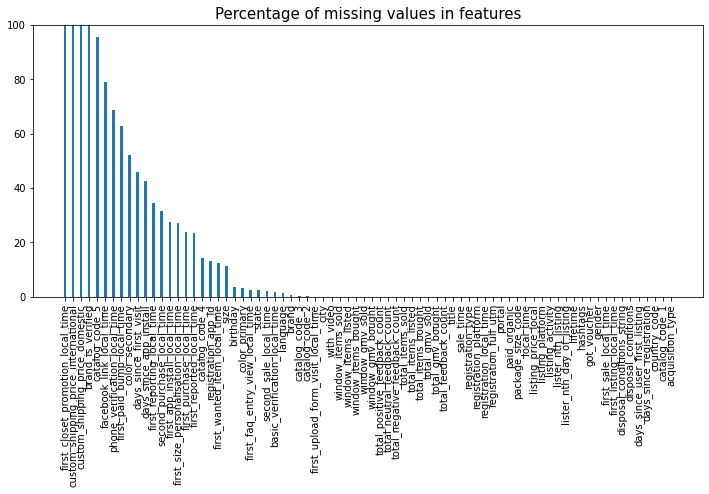

In [9]:
mising_data_counts = dict(data.isnull().sum())
numb_of_missing_sort, feature_names_sort =zip(*sorted(zip(mising_data_counts.values(), mising_data_counts.keys()), reverse = True))
normalised_list1 = [x*100/data.shape[0] for x in numb_of_missing_sort]

plt.figure(figsize=(12, 5))
scale_dim = [i*30 for i in range(len(normalised_list1))]
plt.bar(scale_dim, normalised_list1, width = 10)
plt.ylim(0, 100) 
plt.xticks(scale_dim, feature_names_sort, rotation=90)
plt.title("Percentage of missing values in features", fontsize=15)
plt.show()

dropping features which has more than 90% missing values 

In [10]:
features_to_drop = [name for percent,name in zip(normalised_list1,feature_names_sort) if percent > 90]
data.drop(columns = features_to_drop, inplace = True)
print(f"features to be dropped {features_to_drop}")


features to be dropped ['first_closet_promotion_local_time', 'custom_shipping_price_international', 'custom_shipping_price_domestic', 'brand_is_verified', 'catalog_code_5']


C:\Users\marty\anaconda3\envs\tf_gpu\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Categorical feature analysis 


replacing missing values with "NaN"

In [11]:
p = re.compile(r'.*(time).*')
to_remove_from_categorical = {'disposal_conditions','disposal_conditions_string','hashtags','size','title','birthday'}
categorical_features = [key  for (key,value) in dict(data.dtypes).items() if value == "O" if not p.match(key) if key not in to_remove_from_categorical]
categorical_df = data[categorical_features].fillna('NaN').astype("category")

In [12]:
categorical_df.nunique(dropna=False)

portal                      1
brand                    5647
catalog_code_1              4
catalog_code_2             27
catalog_code_3            205
catalog_code_4            346
color_primary              29
color_secondary            29
listing_platform            3
package_size_code           4
city                     5002
country_code                1
gender                      3
language                    2
state                      66
listing_activity            4
acquisition_type            4
got_voucher                 2
paid_organic                2
registration_full_utm     594
registration_platform       4
registration_type           5
dtype: int64

features with 1 unique value does not bring any value so we drop it 

In [13]:
features_to_drop = [key for (key,value) in dict(categorical_df.nunique(dropna=False)).items() if value == 1] 
print(f"features which will be removed: {features_to_drop}")

features which will be removed: ['portal', 'country_code']


In [14]:
categorical_df = categorical_df.drop(columns = features_to_drop) 

adding target and with_video to make work easier 

In [15]:
categorical_df["target"] =pd.Series(target, index=categorical_df.index)
categorical_df["with_video"] = data["with_video"]

Some functions to make feature analysis plots...

In [16]:
## sorts data column categories by chi2 score 
def sort_by_chi2(df, column, target):
    
    # % of data
    percents = df.loc[:,column].value_counts(normalize = True, sort = False, dropna = False)
    total = pd.DataFrame({"names": percents.index.get_level_values(0), "total": percents})
    
    # chi2 
    lb = LabelBinarizer()
    lbenc = lb.fit_transform(df[[column]])
    fs = SelectKBest(score_func=chi2, k="all")
    fs.fit(lbenc, df[target])
    fs.scores_.resize(lb.classes_.shape)
    fs.pvalues_ .resize(lb.classes_.shape)
    data_chi = pd.DataFrame({'names': lb.classes_,
                  'score_chi': fs.scores_,
                 "p": fs.pvalues_})
    total = pd.merge(total, data_chi, how="left", on=["names", "names"])   
    total.sort_values(by = "score_chi", axis = 0, ascending = False, inplace = True)
    return total

## plots most frequent categoreis and categories with highest chi2
def plot_cat_10(name):
    data_sorted =  sort_by_chi2(categorical_df, name, "target")
    if len(data_sorted.index) < 10:
        k = len(data_sorted.index)
    else:
        k = 10 
        
    data_sorted.sort_values(by=['score_chi'], ascending=False, inplace=True)
    labels = data_sorted["names"][:k]
    
    best = categorical_df[name].value_counts(normalize = True, dropna = False)[:k]
    labels_best = list(best.index.get_level_values(0))
    
    
    x = np.arange(k)
    fig, axs = plt.subplots(1, 2, figsize=(10, 5), sharey=False)
    axs[0].bar(x, height = data_sorted["score_chi"][:k])
    axs[1].bar(x,height = best)
    fig.suptitle(name)
    axs[0].set_xticks(x)
    axs[0].set_xticklabels(labels,rotation = 45, ha="right")
    axs[0].set_title(f"top {k} with highest chi2 score, explains {data_sorted.iloc[:k,1].sum().round(3)} data")
    axs[1].set_xticks(x)
    axs[1].set_xticklabels(labels_best,rotation = 45, ha="right")
    axs[1].set_title(f"top {k} categories")
    
    sums = data_sorted.iloc[:,1].round(3).astype(str)
    rects = axs[0].patches
    for rect, sum in zip(rects, sums):
        height = rect.get_height()
        axs[0].text(rect.get_x() + rect.get_width() / 2, height, f"t:{sum}",
                ha='center', va='bottom')
    fig.tight_layout()
    data_sorted["names"] = name + " " + data_sorted["names"]
    return data_sorted[["names","score_chi", "p"]][:k]

I will check which categories are most popular and which are most dependent on target by chi2 test 

### brands

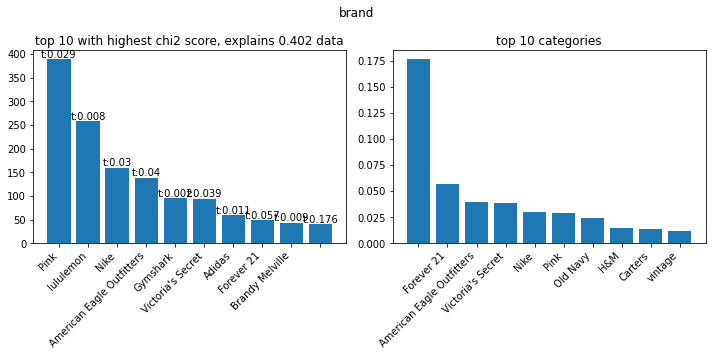

In [17]:
brands_best = plot_cat_10("brand")

### catalog_code_1

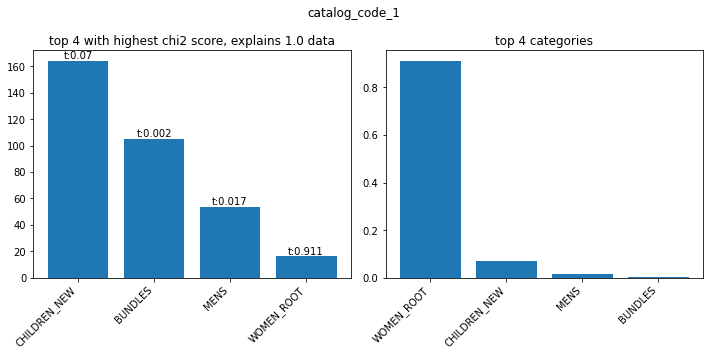

In [18]:
catalog_code_1_best = plot_cat_10("catalog_code_1")

### catalog_code_2

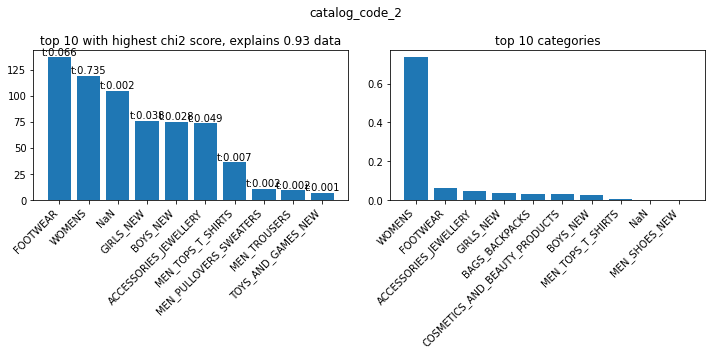

In [19]:
catalog_code_2_best = plot_cat_10("catalog_code_2")

### catalog_code_3

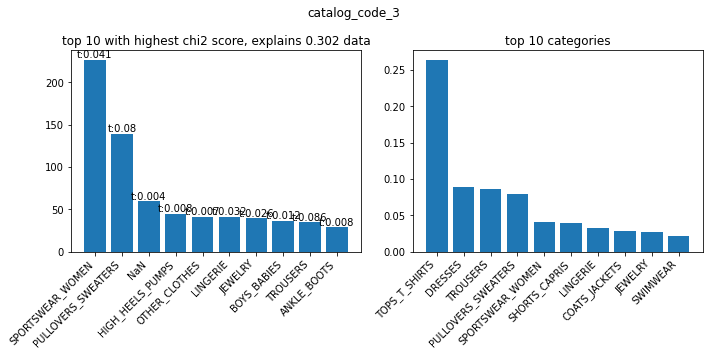

In [20]:
catalog_code_3_best = plot_cat_10("catalog_code_3")

### catalog_code_4

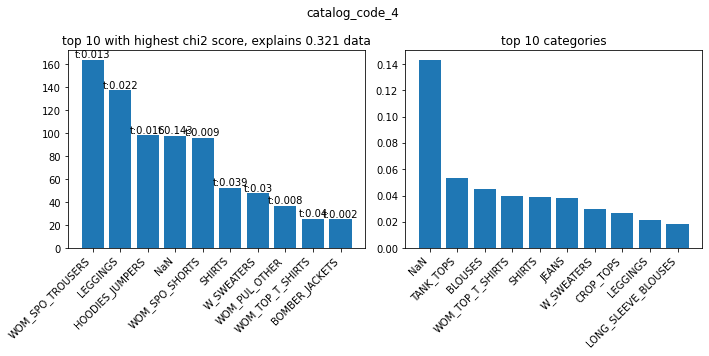

In [21]:
catalog_code_4_best = plot_cat_10('catalog_code_4')

### color_primary

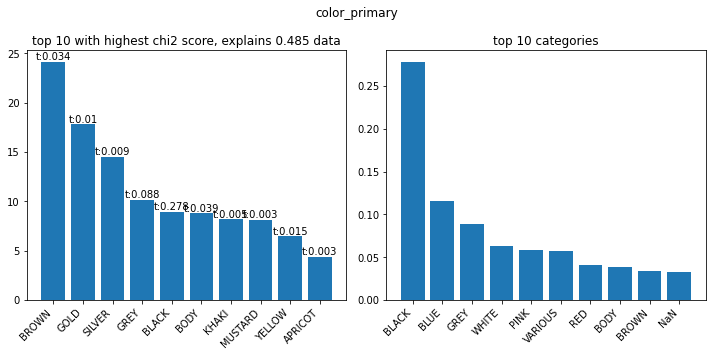

In [22]:
color_primary_best = plot_cat_10("color_primary")

### color_secondary

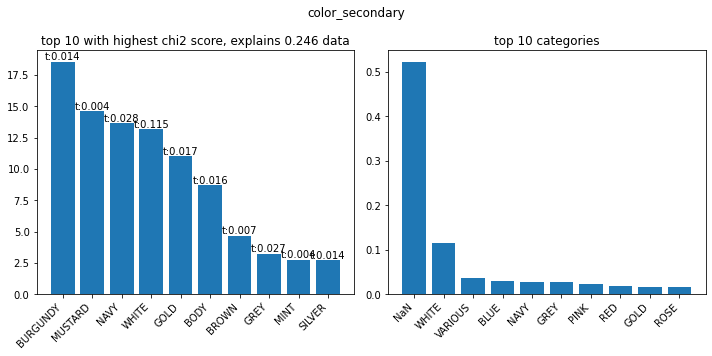

In [23]:
color_secondary_best = plot_cat_10("color_secondary")

### listing_platform

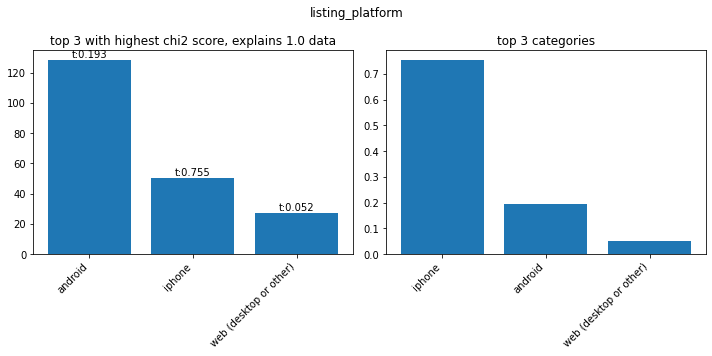

In [24]:
listing_platform_best = plot_cat_10("listing_platform")

### package_size_code

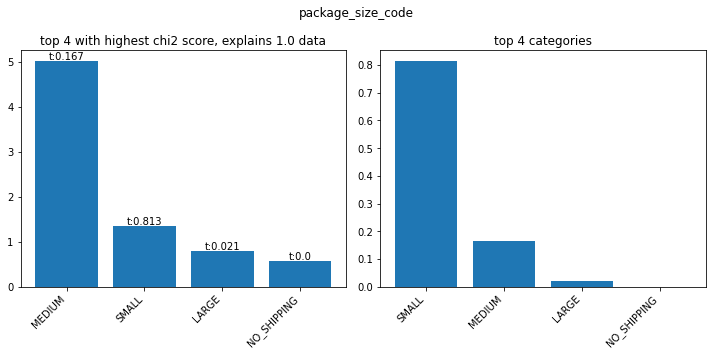

In [25]:
package_size_code_best = plot_cat_10("package_size_code")

### city

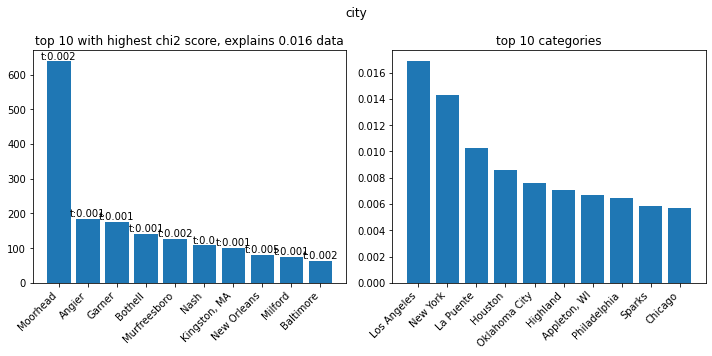

In [26]:
city_best = plot_cat_10("city")

### gender

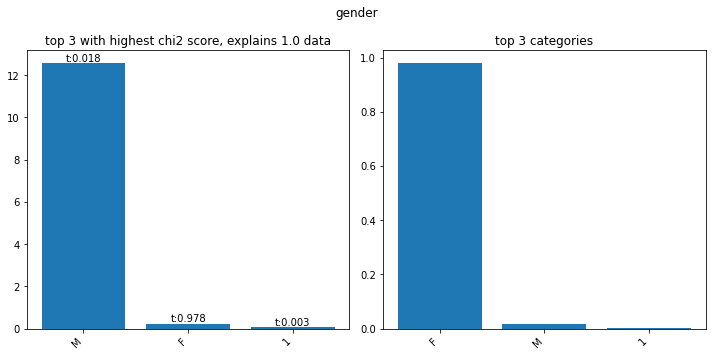

In [27]:
gender_best = plot_cat_10("gender")

### language

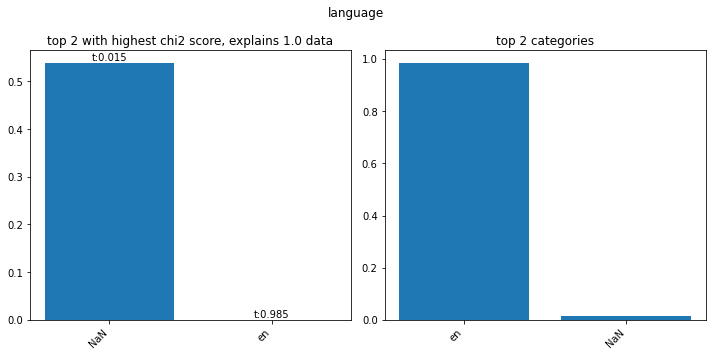

In [28]:
language_best = plot_cat_10("language")

### state

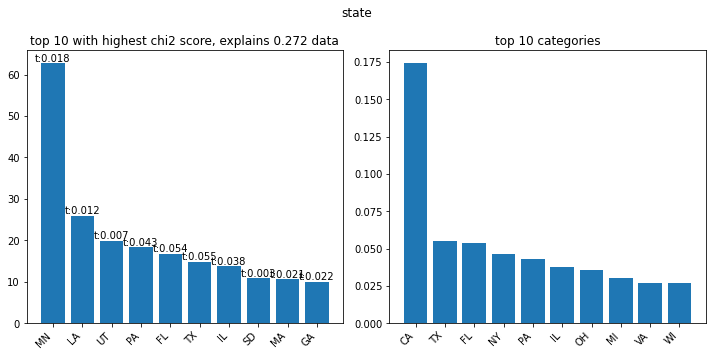

In [29]:
state_best = plot_cat_10("state")

### listing_activity

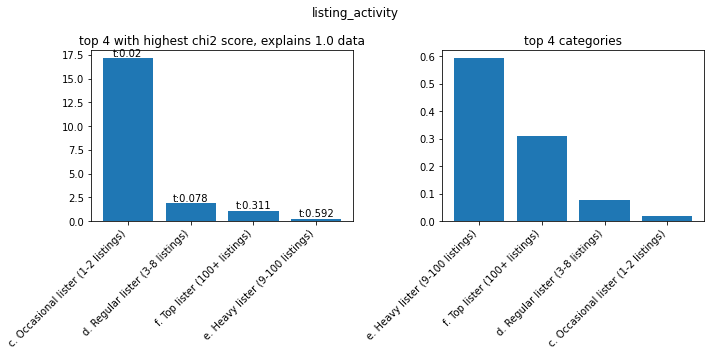

In [30]:
listing_activity_best = plot_cat_10("listing_activity")

### acquisition_type

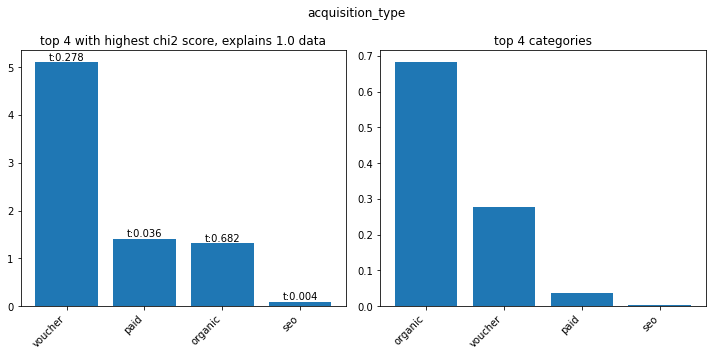

In [31]:
acquisition_type_best = plot_cat_10("acquisition_type")

### paid_organic

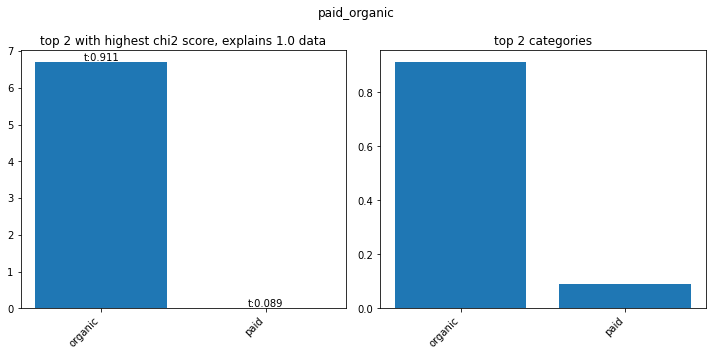

In [32]:
paid_organic_best = plot_cat_10("paid_organic")

### registration_platform

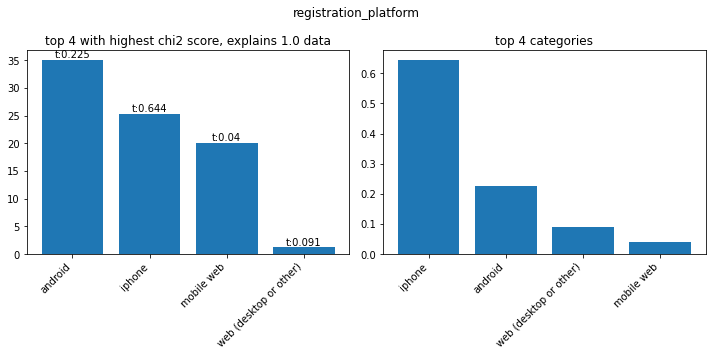

In [33]:
registration_platform_best = plot_cat_10("registration_platform")

### registration_type

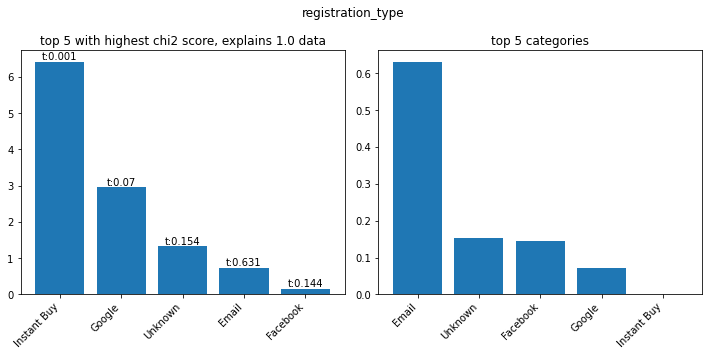

In [34]:
registration_type_best = plot_cat_10("registration_type")

### disposal_conditions 

encoding disposal conditions

In [35]:
mlb = MultiLabelBinarizer()
disposal_conditions_encoded = mlb.fit_transform(data["disposal_conditions"][:])

In [36]:
disposal_conditions_encoded = pd.DataFrame(disposal_conditions_encoded, columns = ["Sell","Swap"])

In [37]:
reset_target = target.reset_index(drop = True)
disposal_conditions_encoded["target"] = reset_target

In [38]:

    fs = SelectKBest(score_func=chi2, k="all")
    fs.fit(disposal_conditions_encoded.iloc[:,:2], reset_target)
    data_chi = pd.DataFrame({'names': disposal_conditions_encoded.columns[:2],
                  'score_chi': fs.scores_,
                 "p": fs.pvalues_})
    disposal_conditions_best = data_chi[["names", "score_chi"]]

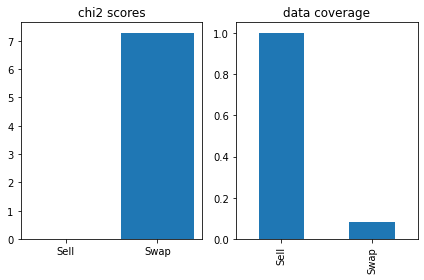

In [39]:

warnings.filterwarnings("ignore")

plt.subplot(121)
plt.bar(x = data_chi["names"], height = data_chi["score_chi"])
plt.title("chi2 scores")
plt.subplot(122)
(disposal_conditions_encoded.iloc[:,:2].sum()/disposal_conditions_encoded.shape[0] ).plot.bar(title = "data coverage")
plt.tight_layout()
plt.show()

### hashtag encoding and analysis 

if hash exist = 1 ,else 0 

In [40]:
def if_hash_exist(X):
    return(X.apply(lambda y: y.apply(lambda x: 1 if len(x)>0 else 0)))

transformer = FunctionTransformer(if_hash_exist)
hash_data =  transformer.transform(data[["hashtags"]])
hash_data_frame= pd.DataFrame({"hash" : hash_data.iloc[:,0] , "target": target})

In [41]:
fs = SelectKBest(score_func=chi2, k="all")
fs.fit(hash_data, target)

SelectKBest(k='all', score_func=<function chi2 at 0x000001B487B51C18>)

In [42]:
print(f"chi2 score = {fs.scores_[0]}, p value = {fs.pvalues_[0]}")

chi2 score = 32.12865899451609, p value = 1.4429300484544113e-08


### Size encoding 

because many unique values exist, we will keep only most frequent

In [43]:
data["size"].value_counts()

M / 8            16000
S / 4            15706
L / 12           10210
S / 6             7226
XS / 2            6803
                 ...  
S / 2                1
14                   1
From 3 months        1
40G                  1
22.2 mm / 13         1
Name: size, Length: 190, dtype: int64

most common values are S M L XS S, lets do one hot encoding for it

In [44]:
transformer = FunctionTransformer(lambda x: x.apply(lambda x: x.str.extract(r'(X |S |(XS )|(XL )|L |M )')[0]))

# pipe for future use 
size_pipe = Pipeline([('extract', transformer), ('onehot', OneHotEncoder(handle_unknown = 'ignore', sparse = False))])



In [45]:
transformed_data = transformer.transform(data[["size"]])
lb = LabelBinarizer()
lb_data = transformed_data.astype(str)
lbenc = lb.fit_transform(lb_data)
fs = SelectKBest(score_func=chi2, k="all")
fs.fit(lbenc, target)
fs.scores_.resize(lb.classes_.shape)
fs.pvalues_ .resize(lb.classes_.shape)
data_chi = pd.DataFrame({'names': lb.classes_,
                  'score_chi': fs.scores_,
                 "p": fs.pvalues_})
data_chi.sort_values(by = ["score_chi"], ascending = False, inplace= True)
size_best = data_chi[["names", "score_chi"]]

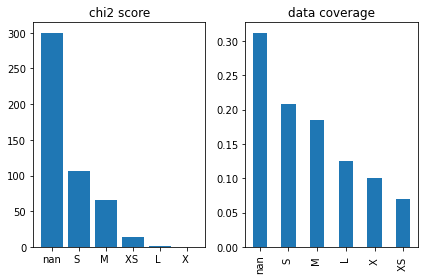

In [46]:
plt.subplot(121)
plt.bar(data_chi["names"], height = data_chi["score_chi"])
plt.title("chi2 score")
plt.subplot(122)
transformed_data.iloc[:,0].value_counts(normalize = True, dropna = False).plot.bar(title = "data coverage")
plt.tight_layout()
plt.show()

### With_video

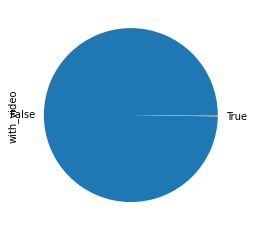

In [47]:
data["with_video"].value_counts().plot.pie()
plt.show()

lets check how it looks overall  

In [48]:
all_data = brands_best.append([catalog_code_1_best, 
           catalog_code_2_best, 
           catalog_code_3_best, 
           catalog_code_4_best, 
           color_primary_best,
           color_secondary_best,
           listing_platform_best,
           package_size_code_best,
           city_best,
           gender_best,
           language_best,
           state_best,
           listing_activity_best,
           acquisition_type_best,
           paid_organic_best,
           registration_platform_best,
           registration_type_best,
           disposal_conditions_best,
           size_best,
          ], ignore_index = True)

all_data.sort_values(by = ["score_chi"], ascending = False, inplace = True)

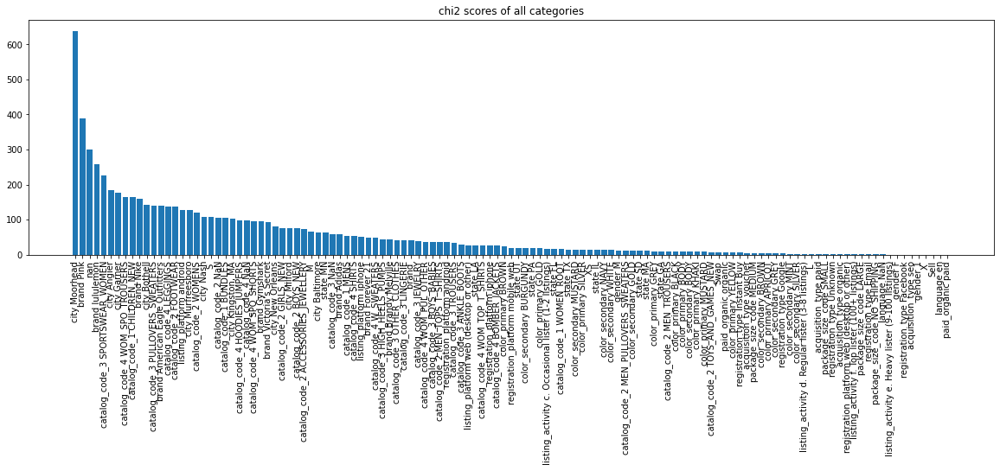

In [49]:
plt.figure(figsize = (20,5))
plt.bar(x = all_data["names"], height = all_data["score_chi"])
plt.xticks(rotation = 90)
plt.title("chi2 scores of all categories")
plt.show()

## date/time feature analysis

extract date/time features

In [50]:
datetime_features = [feature for feature in data.columns if p.match(feature) if feature not in ['lifetime']]

In [51]:
data[datetime_features].head()

,local_time,sale_time,basic_verification_local_time,facebook_link_local_time,first_app_install_local_time,first_faq_entry_view_local_time,first_listing_local_time,first_paid_bump_local_time,first_purchase_local_time,first_reported_local_time,first_reporting_local_time,first_sale_local_time,first_size_personalisation_local_time,first_upload_form_visit_local_time,first_wanted_item_local_time,phone_verification_local_time,second_purchase_local_time,second_sale_local_time,registration_local_time
10,2019-04-18T07:14:48.000-07:00,2019-04-24T07:33:43.000-07:00,2015-07-05T16:30:14.000-07:00,None,2015-07-04T18:03:02.000-07:00,2017-03-21T07:07:39.000-07:00,2015-07-05T12:07:24.000-07:00,2019-03-08T23:24:46.000-07:00,2015-07-13T17:26:31.000-07:00,2015-08-29T12:37:18.000-07:00,2015-08-27T11:25:11.000-07:00,2015-07-07T14:43:02.000-07:00,2015-07-04T18:04:40.000-07:00,2015-07-04T18:07:16.000-07:00,2015-07-11T16:49:21.000-07:00,None,2015-07-15T10:59:27.000-07:00,2015-07-08T18:01:16.000-07:00,2015-07-04T18:03:27.000-07:00
13,2018-10-23T17:41:48.000-07:00,2019-03-31T22:06:42.000-07:00,2015-07-13T12:13:58.000-07:00,None,2015-07-13T12:13:56.000-07:00,2015-12-30T09:54:29.000-07:00,2015-07-09T17:31:11.000-07:00,None,2015-09-18T11:48:19.000-07:00,2015-12-24T20:23:06.000-07:00,2015-12-24T23:38:05.000-07:00,2015-07-14T08:58:07.000-07:00,2015-11-28T14:53:31.000-07:00,2015-07-08T09:42:07.000-07:00,2015-07-14T11:22:17.000-07:00,None,2016-06-17T15:05:53.000-07:00,2015-07-17T10:08:14.000-07:00,2015-07-07T19:03:04.000-07:00
29,2018-09-19T03:36:55.000-07:00,2018-09-19T04:15:43.000-07:00,None,None,None,2018-09-19T03:06:23.000-07:00,2018-09-19T03:36:55.000-07:00,None,None,None,2018-09-19T03:09:42.000-07:00,2018-09-19T04:06:37.000-07:00,2018-09-19T01:18:58.000-07:00,2018-09-19T03:19:36.000-07:00,2018-09-19T03:04:07.000-07:00,None,None,2018-09-19T04:15:43.000-07:00,2018-09-19T01:06:21.000-07:00
36,2018-07-30T17:52:27.000-07:00,2018-08-13T19:14:50.000-07:00,2014-05-19T18:59:13.000-07:00,None,None,2016-01-15T23:12:09.000-07:00,2014-05-20T20:04:06.000-07:00,None,2014-05-20T18:45:31.000-07:00,2015-11-19T15:04:05.000-07:00,2015-09-04T09:54:06.000-07:00,2015-09-04T09:12:53.000-07:00,2018-03-30T21:09:46.000-07:00,2014-05-20T20:04:06.000-07:00,2015-09-02T09:38:27.000-07:00,None,2014-05-20T20:55:21.000-07:00,2015-09-04T23:50:47.000-07:00,2014-05-19T18:59:13.000-07:00
37,2018-11-18T15:43:03.000-07:00,2018-12-25T22:50:43.000-07:00,2014-01-24T10:11:08.000-07:00,None,None,2016-04-24T13:04:23.000-07:00,2015-06-14T21:51:25.000-07:00,2017-10-07T16:12:59.000-07:00,2015-08-01T00:15:21.000-07:00,None,None,2015-08-20T12:05:23.000-07:00,2015-06-14T21:43:16.000-07:00,2015-06-14T21:46:26.000-07:00,2015-08-01T00:15:00.000-07:00,None,None,2016-04-16T18:24:40.000-07:00,2014-01-24T10:11:08.000-07:00


we are not interested in sale_time as it was used for targets so drop

In [52]:
datetime_features.remove("sale_time")

converting to datetime format 

In [53]:
datetime_data = data[datetime_features].apply(pd.to_datetime, format="%Y-%m-%dT%H:%M:%S.%f%z")

In [54]:
datetime_data.head()

,local_time,basic_verification_local_time,facebook_link_local_time,first_app_install_local_time,first_faq_entry_view_local_time,first_listing_local_time,first_paid_bump_local_time,first_purchase_local_time,first_reported_local_time,first_reporting_local_time,first_sale_local_time,first_size_personalisation_local_time,first_upload_form_visit_local_time,first_wanted_item_local_time,phone_verification_local_time,second_purchase_local_time,second_sale_local_time,registration_local_time
10,2019-04-18 07:14:48-07:00,2015-07-05 16:30:14-07:00,NaT,2015-07-04 18:03:02-07:00,2017-03-21 07:07:39-07:00,2015-07-05 12:07:24-07:00,2019-03-08 23:24:46-07:00,2015-07-13 17:26:31-07:00,2015-08-29 12:37:18-07:00,2015-08-27 11:25:11-07:00,2015-07-07 14:43:02-07:00,2015-07-04 18:04:40-07:00,2015-07-04 18:07:16-07:00,2015-07-11 16:49:21-07:00,NaT,2015-07-15 10:59:27-07:00,2015-07-08 18:01:16-07:00,2015-07-04 18:03:27-07:00
13,2018-10-23 17:41:48-07:00,2015-07-13 12:13:58-07:00,NaT,2015-07-13 12:13:56-07:00,2015-12-30 09:54:29-07:00,2015-07-09 17:31:11-07:00,NaT,2015-09-18 11:48:19-07:00,2015-12-24 20:23:06-07:00,2015-12-24 23:38:05-07:00,2015-07-14 08:58:07-07:00,2015-11-28 14:53:31-07:00,2015-07-08 09:42:07-07:00,2015-07-14 11:22:17-07:00,NaT,2016-06-17 15:05:53-07:00,2015-07-17 10:08:14-07:00,2015-07-07 19:03:04-07:00
29,2018-09-19 03:36:55-07:00,NaT,NaT,NaT,2018-09-19 03:06:23-07:00,2018-09-19 03:36:55-07:00,NaT,NaT,NaT,2018-09-19 03:09:42-07:00,2018-09-19 04:06:37-07:00,2018-09-19 01:18:58-07:00,2018-09-19 03:19:36-07:00,2018-09-19 03:04:07-07:00,NaT,NaT,2018-09-19 04:15:43-07:00,2018-09-19 01:06:21-07:00
36,2018-07-30 17:52:27-07:00,2014-05-19 18:59:13-07:00,NaT,NaT,2016-01-15 23:12:09-07:00,2014-05-20 20:04:06-07:00,NaT,2014-05-20 18:45:31-07:00,2015-11-19 15:04:05-07:00,2015-09-04 09:54:06-07:00,2015-09-04 09:12:53-07:00,2018-03-30 21:09:46-07:00,2014-05-20 20:04:06-07:00,2015-09-02 09:38:27-07:00,NaT,2014-05-20 20:55:21-07:00,2015-09-04 23:50:47-07:00,2014-05-19 18:59:13-07:00
37,2018-11-18 15:43:03-07:00,2014-01-24 10:11:08-07:00,NaT,NaT,2016-04-24 13:04:23-07:00,2015-06-14 21:51:25-07:00,2017-10-07 16:12:59-07:00,2015-08-01 00:15:21-07:00,NaT,NaT,2015-08-20 12:05:23-07:00,2015-06-14 21:43:16-07:00,2015-06-14 21:46:26-07:00,2015-08-01 00:15:00-07:00,NaT,NaT,2016-04-16 18:24:40-07:00,2014-01-24 10:11:08-07:00


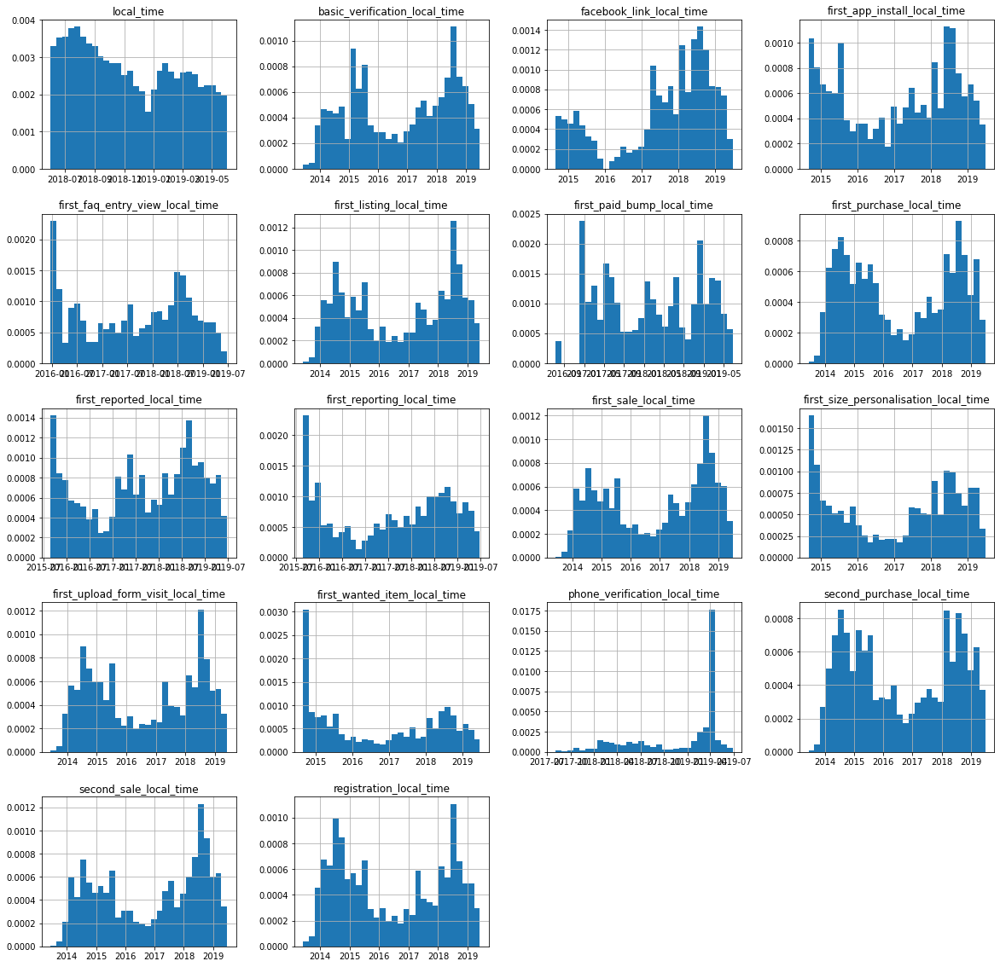

In [55]:
datetime_data.hist(figsize= (20,20), bins = 30, density = True)
plt.show()

In [56]:
subtracted = datetime_data.apply(lambda x: (datetime_data['local_time'] - x).dt.days, axis = 0)

birthday, lets calculate difference between local time

In [57]:
birthdays = pd.to_datetime(data["birthday"] ,format="%Y-%m-%d").dt.tz_localize('UTC')
subtracted["birthdays"] = (datetime_data['local_time'].dt.tz_convert('UTC') - birthdays).dt.days

dropping local_time 

In [58]:
subtracted.drop(columns = ["local_time"], inplace = True)
datetime_features = list(subtracted.columns)

In [59]:
subtracted.head()

,basic_verification_local_time,facebook_link_local_time,first_app_install_local_time,first_faq_entry_view_local_time,first_listing_local_time,first_paid_bump_local_time,first_purchase_local_time,first_reported_local_time,first_reporting_local_time,first_sale_local_time,first_size_personalisation_local_time,first_upload_form_visit_local_time,first_wanted_item_local_time,phone_verification_local_time,second_purchase_local_time,second_sale_local_time,registration_local_time,birthdays
10,1382.0,NaN,1383.0,758.0,1382,40.0,1374.0,1327.0,1329.0,1380,1383.0,1383.0,1376.0,NaN,1372.0,1379.0,1383,8357.0
13,1198.0,NaN,1198.0,1028.0,1202,NaN,1131.0,1033.0,1033.0,1197,1060.0,1203.0,1197.0,NaN,858.0,1194.0,1203,9497.0
29,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,0.0,-1,0.0,0.0,0.0,NaN,NaN,-1.0,0,7377.0
36,1532.0,NaN,NaN,926.0,1531,NaN,1531.0,984.0,1060.0,1060,121.0,1531.0,1062.0,NaN,1531.0,1059.0,1532,10589.0
37,1759.0,NaN,NaN,938.0,1252,406.0,1205.0,NaN,NaN,1186,1252.0,1252.0,1205.0,NaN,NaN,945.0,1759,9173.0


some function to plot densities 

In [60]:
def plot_density(data, target, name):
    x = data[target == 1][name]
    y = data[target == 0][name]
    bins = 20
    plt.hist([x, y], bins, label=['sold', 'not sold'], density = True)
    plt.legend(loc='upper right')
    plt.title(f"densitys of days from {name} to local_time")

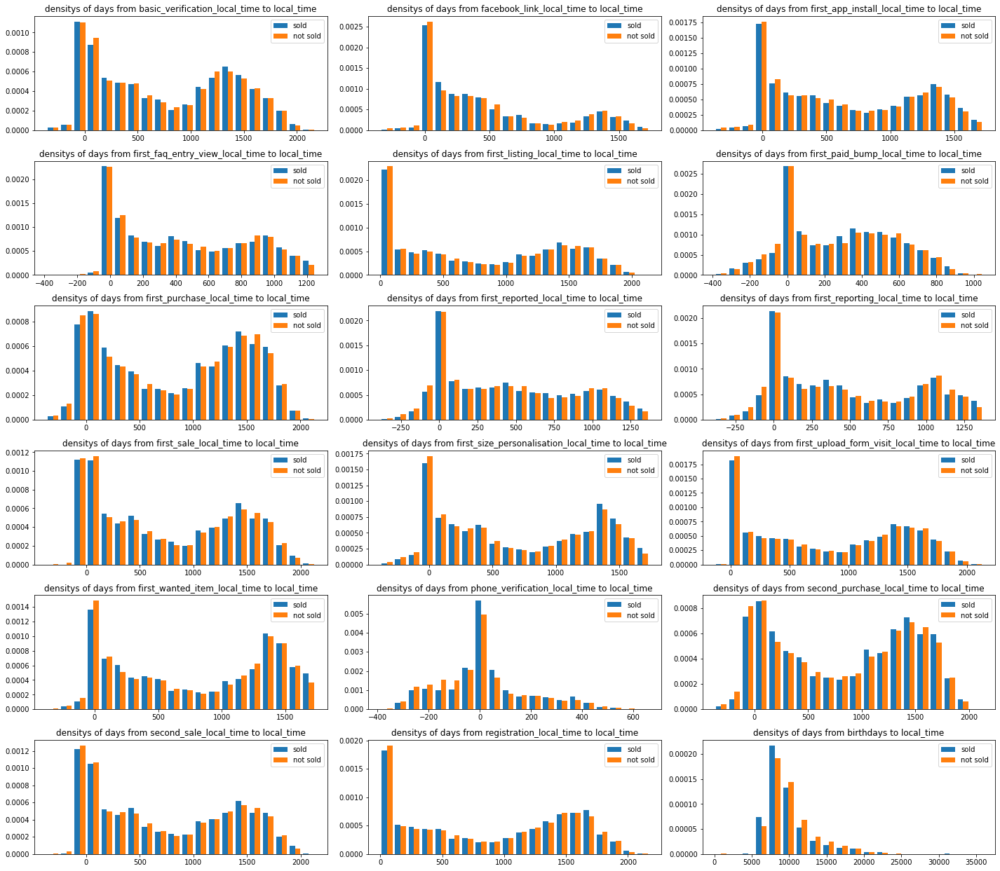

In [61]:
plt.figure(figsize = (20,20))

for i in range(len(datetime_features)):
    plt.subplot(7,3,(i+1))
    plot_density(subtracted, target, datetime_features[i])
plt.tight_layout()
plt.show()

densities look very similar, lets do anova test:

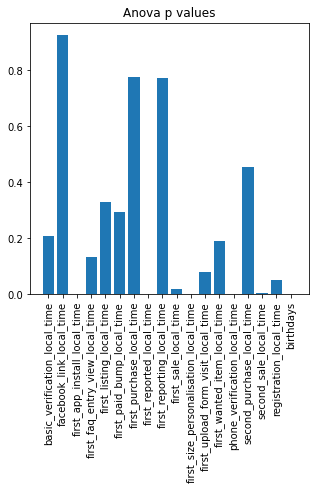

In [62]:
data_wo_na = subtracted.fillna(0)
F, p =f_classif(data_wo_na, target)
fig, ax = plt.subplots(figsize=(5,5))
ax.bar(np.arange(len(F)), height = p, tick_label =datetime_features)
plt.xticks(rotation=90)
plt.title("Anova p values")
plt.show()

In [63]:
print(f" rejected with 0.05 significance {list(subtracted.columns[p<0.05])}")

 rejected with 0.05 significance ['first_app_install_local_time', 'first_reported_local_time', 'first_sale_local_time', 'first_size_personalisation_local_time', 'phone_verification_local_time', 'second_sale_local_time', 'registration_local_time', 'birthdays']


lets check correlations

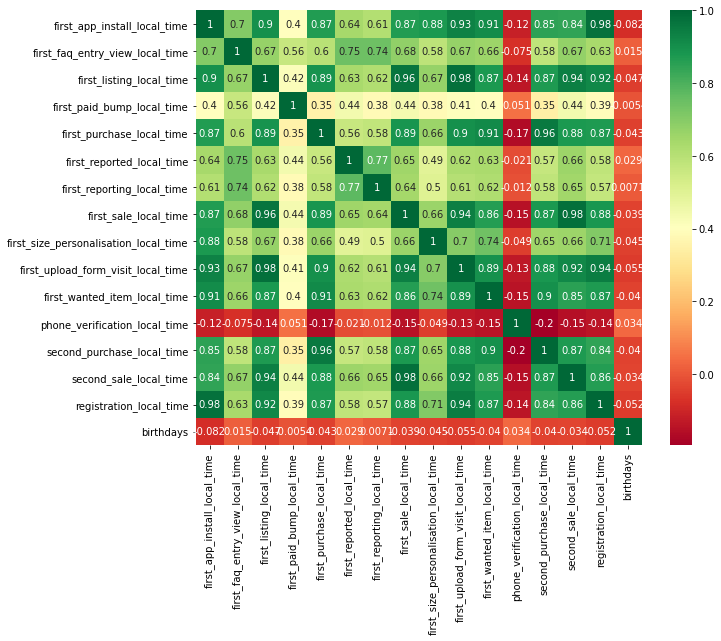

In [64]:
corrmat = subtracted.iloc[:,2:].corr()
top_corr_features = corrmat.index
plt.figure(figsize=(10,8))
#plot heat map
g=sns.heatmap(subtracted[top_corr_features].corr(),annot=True,cmap="RdYlGn")

features are very correlated, so having a lot of them in model wont bring much information

lets visualise it on first 3 principal components 

In [65]:
x = StandardScaler().fit_transform(data_wo_na)
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2', 'principal component 3'])
principalDf["target"] = target.reset_index(drop = True)


fig = px.scatter_3d(principalDf, x='principal component 1', y='principal component 2', z='principal component 3',
              color='target')
fig.show()

## Continuous 

In [66]:
continuous_features = [
    "listing_price_local",
    "days_since_app_install",
    "days_since_first_visit",
    "days_since_registration",
    "days_since_user_first_listing",
    "lister_nth_day_of_listing" ,
    "lister_nth_listing",
    "total_items_sold",
    'total_feedback_count',
     'total_gmv_bought',
     'total_gmv_sold',
     'total_items_bought',
     'total_items_listed',
     'total_negative_feedback_count',
     'total_neutral_feedback_count',
     'total_positive_feedback_count',
     'window_gmv_bought',
     'window_gmv_sold',
     'window_items_bought',
     'window_items_listed',
     'window_items_sold',]

continuous_features = [i for i in continuous_features if i in test_raw.columns]

In [67]:
continuous_data = data[continuous_features]
continuous_data.head()

,days_since_app_install,days_since_first_visit,days_since_registration,days_since_user_first_listing,lister_nth_day_of_listing,lister_nth_listing,total_items_sold,total_feedback_count,total_gmv_bought,total_gmv_sold,total_items_bought,total_items_listed,total_negative_feedback_count,total_neutral_feedback_count,total_positive_feedback_count,window_gmv_bought,window_gmv_sold,window_items_bought,window_items_listed,window_items_sold
10,0.0,NaN,1383,1382,235,3774,1260,1155,718.52,7493.92,86,3799,4,4,1147,94.45,829.70,9,494,101
13,NaN,NaN,1203,1202,1044,10539,2155,2072,190.40,41671.05,19,10544,8,14,2050,0.00,3692.96,0,1349,190
29,NaN,NaN,0,0,1,1,4,0,0.00,45.65,0,4,0,0,0,0.00,45.65,0,4,4
36,NaN,NaN,1532,1531,55,254,97,152,1797.11,547.25,176,272,1,1,150,47.00,0.00,5,20,0
37,NaN,NaN,1759,1252,14,75,6,7,11.70,150.75,1,78,0,0,7,0.00,0.00,0,10,0


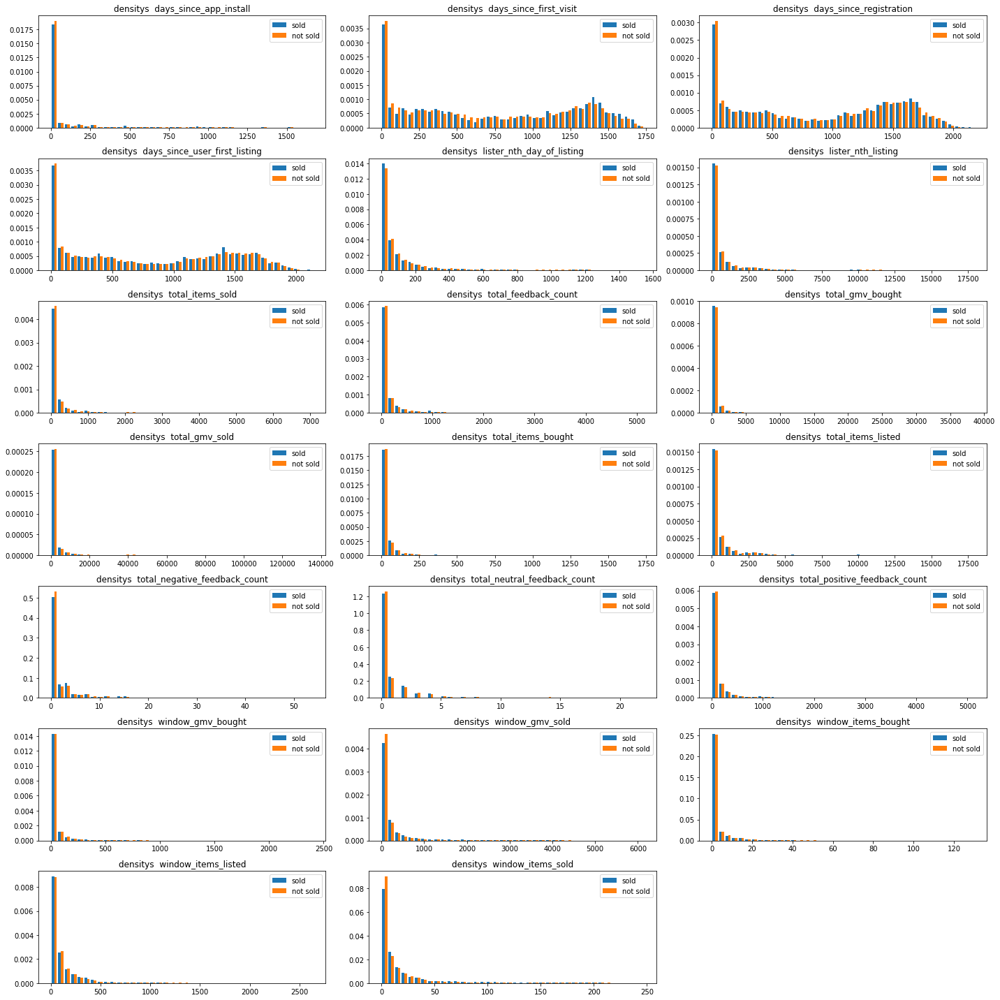

In [68]:
## plots densities of variables for sold and not sold 

def plot_density_cont(data, target, name):
    x = data[target == 1][name].dropna()
    y = data[target == 0][name].dropna()
    bins = 40
    plt.hist([x, y], bins, label=['sold', 'not sold'], density = True)
    plt.legend(loc='upper right')
    plt.title(f"densitys  {name}")

plt.figure(figsize = (20,20))
for i in range(len(continuous_features)):
    plt.subplot(7,3,(i+1))
    plot_density_cont(continuous_data, target, continuous_features[i])
plt.tight_layout()
plt.show()

All densities look very similar, not great for classification task. Lets do anova 

lets impute NaN with means

In [69]:
imp = SimpleImputer()
imp_cont_data = pd.DataFrame(imp.fit_transform(continuous_data))
imp_cont_data.index = continuous_data.index
imp_cont_data.columns = continuous_data.columns

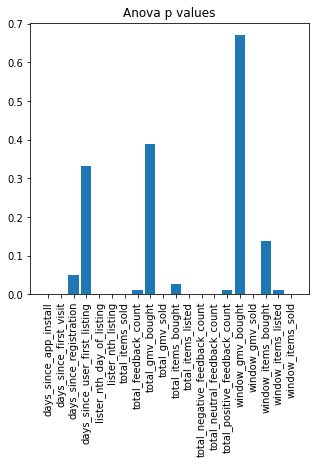

In [70]:

F, p =f_classif(imp_cont_data, target)
fig, ax = plt.subplots(figsize=(5,5))
ax.bar(np.arange(len(F)), height = p, tick_label =continuous_features)
plt.xticks(rotation=90)
plt.title("Anova p values")
plt.show()

In [71]:
print(f" rejected with 0.05 significance {list(imp_cont_data.columns[p<0.05])}")

 rejected with 0.05 significance ['days_since_app_install', 'days_since_first_visit', 'days_since_registration', 'lister_nth_day_of_listing', 'lister_nth_listing', 'total_items_sold', 'total_feedback_count', 'total_gmv_sold', 'total_items_bought', 'total_items_listed', 'total_negative_feedback_count', 'total_neutral_feedback_count', 'total_positive_feedback_count', 'window_gmv_sold', 'window_items_listed', 'window_items_sold']


Lets check correlations 

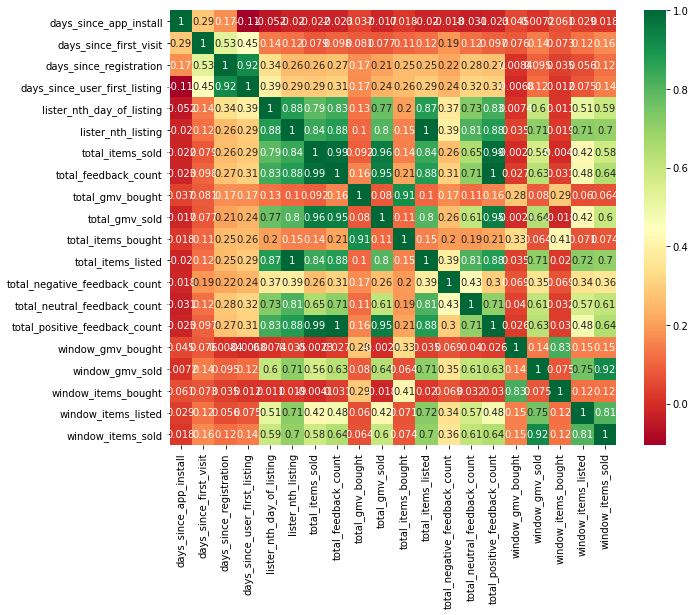

In [72]:
corrmat = imp_cont_data.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(10,8))
#plot heat map
g=sns.heatmap(imp_cont_data[top_corr_features].corr(),annot=True,cmap="RdYlGn")

most of the features are highly correlated 

### PCA on Continuous 

In [73]:
x = StandardScaler().fit_transform(imp_cont_data)
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2', 'principal component 3'])
principalDf["target"] = target.reset_index(drop = True)


fig = px.scatter_3d(principalDf, x='principal component 1', y='principal component 2', z='principal component 3',
              color='target')
fig.show()

it really doesnt look like easily classified 

# Pipeline

features which has more than 90% of data will be kept

Categorical data will be one hot encoded with max 10 features which will be selected by chi2 score

Datetime: time zone will be removed, difference between local_time and other time will be takes. local time removed, data will be scaled. Missing data will be imputed with 0 

Continuous: scaled and mean imputed if missing.



In [89]:
# this transformer will do one hot encoding for max 10 categories choses by chi2 
# X- dataframe 
# y - series, list 
# output - array 


class OneHotchi2(BaseEstimator, TransformerMixin):
    def __init__(self, **kwargs):
        self._k = 10
        

    def fit(self,X, y):
        self.labels = []
        X = pd.DataFrame(X).astype("str")
        for serie in X:
            lb = LabelBinarizer()
            lbenc = lb.fit_transform(X[serie])
            fs = SelectKBest(score_func=chi2, k="all")
            fs.fit(lbenc, list(y))
            scores_pad =fs.scores_.resize(lb.classes_.shape)
            p_pad = fs.pvalues_ .resize(lb.classes_.shape)
            data_chi = pd.DataFrame({'names': lb.classes_,
                  'score_chi': fs.scores_,
                 "p": fs.pvalues_})
            data_chi.sort_values(by = "score_chi", axis = 0, ascending = False, inplace = True)
            self.labels.append(list(data_chi['names'][:self._k]))
        self._OneHot = OneHotEncoder(categories = self.labels, handle_unknown= 'ignore', sparse = False)
        self._OneHot.fit(X)

    def transform(self, X):
        return self._OneHot.transform(X)

    def fit_transform(self, X, y, *_):
        self.fit(X,y=y)
        return self._OneHot.transform(X)


In [90]:
def if_hash_exist(X):
    return(X.apply(lambda y: y.apply(lambda x: 1 if len(x)>0 else 0)))

transformer = FunctionTransformer(lambda x: x.apply(lambda x: x.str.extract(r'(X |S |(XS )|(XL )|L |M )')[0]))
size_pipe = Pipeline([('extract', transformer), ('onehot', OneHotEncoder(handle_unknown = 'ignore', sparse = False))])

In [91]:
# transformer for datetime feature preprocessing

def date_time_transformer(X):
    time = X.drop(columns = ["birthday"])
    time = time.apply(lambda x: x.fillna(x['local_time']), axis = 1)
    datetime_data = time.apply(pd.to_datetime, format="%Y-%m-%dT%H:%M:%S.%f%z", utc = True)
    substracted = datetime_data.apply(lambda x: (datetime_data['local_time'] - x).dt.days, axis = 0)
    birthdays = pd.to_datetime(X["birthday"] ,format="%Y-%m-%d").dt.tz_localize('UTC')
    substracted["birthdays"] = (datetime_data['local_time'] - birthdays).dt.days
    substracted.drop(columns = ["local_time"], inplace = True)
    substracted.fillna(0,inplace = True)
    return substracted

In [92]:
# transformer for label binarizer 

class MyLabelBinarizer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.encoder = MultiLabelBinarizer()
    def fit(self, x, y):
        self.encoder.fit(x.iloc[:,0])
        return self
    def transform(self, x):
        data = self.encoder.transform(x.iloc[:,0])
        return data
    
# column transformer will work as feature extractor so to pass series without any transformation    
class PassData(BaseEstimator, TransformerMixin):
    def fit(self, x, y):
        return self
    def transform(self, x):
        return x

In [93]:



pipe_cat = Pipeline([('scaler', SimpleImputer(strategy='constant', fill_value="NaN", copy=False, missing_values = None)), ('onehotchi', OneHotchi2())])


column_trans = ColumnTransformer(transformers=[('Categorical', pipe_cat,
                                                                 ['brand', 
                                                                  'catalog_code_1',
                                                                  'catalog_code_2',
                                                                  'catalog_code_3',
                                                                  'catalog_code_4',
                                                                  'color_primary',
                                                                  'listing_platform',
                                                                  'package_size_code',
                                                                  'city',
                                                                  'gender',
                                                                  'language',
                                                                  'state',
                                                                  'listing_activity',
                                                                  'acquisition_type',
                                                                  'got_voucher',
                                                                  'paid_organic',
                                                                  'registration_full_utm',
                                                                  'registration_platform',
                                                                  'registration_type']),
                                              ('DateTime', FunctionTransformer(date_time_transformer),
                                                                ['local_time',
                                                                 'basic_verification_local_time',
                                                                 'facebook_link_local_time',
                                                                 'first_app_install_local_time',
                                                                 'first_faq_entry_view_local_time',
                                                                 'first_listing_local_time',
                                                                 'first_paid_bump_local_time',
                                                                 'first_purchase_local_time',
                                                                 'first_reported_local_time',
                                                                 'first_reporting_local_time',
                                                                 'first_sale_local_time',
                                                                 'first_size_personalisation_local_time',
                                                                 'first_upload_form_visit_local_time',
                                                                 'first_wanted_item_local_time',
                                                                 'phone_verification_local_time',
                                                                 'second_purchase_local_time',
                                                                 'second_sale_local_time',
                                                                 'registration_local_time',
                                                                 'birthday']),
                                              ('continuous', SimpleImputer(), 
                                                               continuous_features),
                                              ("size", size_pipe , ["size"]),
                                              ("hash", FunctionTransformer(if_hash_exist), ["hashtags"]),
                                              ("disposal", MyLabelBinarizer(), ["disposal_conditions"]),
                                              ('with_video', PassData(), ["with_video"])],  remainder='drop')

Preprocessing_pipe = Pipeline([('column_trans', column_trans), ("scaler", RobustScaler())])


# Models 

load models:

In [74]:
with open(r"logistic_wo_preproc.sav", "rb") as input_file:
    logistic = pickle.load(input_file)
          
with open(r"svm_wo_preproc.sav", "rb") as input_file:
    svm = pickle.load(input_file)
          
with open(r"knn_wo_preproc.sav", "rb") as input_file:
    knn = pickle.load(input_file)
          
with open(r"gradboost_wo_preproc.sav", "rb") as input_file:
    gradboost = pickle.load(input_file)

with open(r"preproc_pipe.sav", "rb") as input_file:
    Preprocessing_pipe = pickle.load(input_file)

In [75]:
with open(r"final_classifier.sav", "rb") as input_file:
    final_classifier = pickle.load(input_file)

lets take raw data to test preprocessing pipe 

lets choose samples with targets

In [76]:
data_raw_target = data_raw[test_raw.columns]
data_raw_target["target"] = target
data_raw_target = data_raw_target[data_raw_target['target'].notna()]

balancing data 

In [77]:
data_balanced = data_raw_target[target== False].sample(target.sum(), random_state = 50).append(data_raw_target[target== True], ignore_index = True)
X = data_balanced.iloc[:,:-1]
Y = data_balanced.iloc[:,-1]

data will be divided into train/validation/test, keeping train + validation in case cross-validation will be used

In [96]:
Preprocessing_pipe.fit(X,Y)
filename = 'preproc_pipe.sav'
pickle.dump(Preprocessing_pipe, open(filename, 'wb'))

In [78]:
X_clean = Preprocessing_pipe.transform(X)
Y_clean = Y.astype(int)

X_CV, X_test, Y_CV, Y_test = tts(X_clean,Y_clean, test_size = 0.2, shuffle = True, random_state = 50)
X_train, X_valid, Y_train, Y_valid = tts(X_CV, Y_CV, test_size = 0.25, shuffle = True, random_state = 50)


In [79]:
X_clean.shape

(34862, 164)

### Data on first 3 principal components 

In [80]:
x = StandardScaler().fit_transform(X_clean)
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2','principal component 3'])
principalDf["target"] = target.reset_index(drop = True)


fig = px.scatter_3d(principalDf, x='principal component 1', y='principal component 2', z='principal component 3',
              color='target')
fig.show()

several models will be checked: 

- Logistic regression with l1 regularization - shouldnt perform well as data doesnt look seperable on pca , but maybe regularization will select specific features.
- SVM with RBF kernel, as kernel might to do the trick 
- ensemble: gradient boosting classifier - could perform best 
- KNN - because why not 

## Logistic regression 


tunning C

In [201]:
## dont run if model is loaded!
acc = []
for i in np.linspace(0.1, 1.2, num = 10):
    lr = LogisticRegression(C = i, solver = "liblinear", penalty = "l1")
    lr.fit(X_test,Y_test)
    acc.append(accuracy_score(Y_valid, lr.predict(X_valid)))
    print(i) ## to know state   

0.1
0.2222222222222222
0.34444444444444444
0.46666666666666656
0.5888888888888888
0.711111111111111
0.8333333333333331
0.9555555555555554
1.0777777777777777
1.2


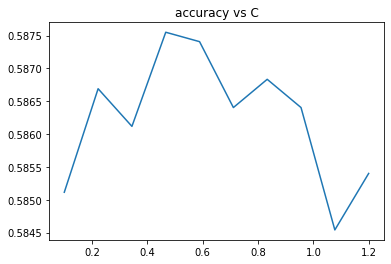

In [202]:
## dont run if model is loaded!
plt.plot(np.linspace(0.1, 1.2, num = 10), acc)
plt.title("accuracy vs C")
plt.show()

best score when c = 0.5

train on train + validation

In [101]:
## dont run if model is loaded!
logistic = LogisticRegression(C = 0.5, solver = "liblinear", penalty = "l1")
logistic.fit(X_CV,Y_CV)

LogisticRegression(C=0.5, penalty='l1', solver='liblinear')

check generalisation

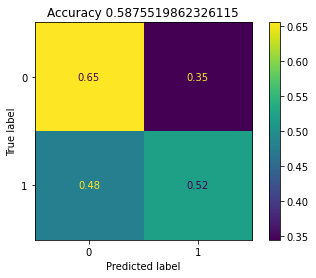

In [102]:
acc_logistic = accuracy_score(Y_test, logistic.predict(X_test))
plot_confusion_matrix(logistic,X_test,Y_test, normalize = "true")
plt.title(f"Accuracy {acc_logistic}")
plt.show()

In [103]:
## lets save it 
filename = 'logistic_wo_preproc.sav'
pickle.dump(logistic, open(filename, 'wb'))

## SVM
lets hope kernel will do its trick 

parameter tunning 

In [ ]:
## dont run if model is loaded!
acc = []
for i in [0.1, 1, 10, 100, 1000, 3000]:
    svm = SVC(C = i, kernel = "rbf")
    svm.fit(X_test,Y_test)
    acc.append(accuracy_score(Y_valid, svm.predict(X_valid)))
    print(i) ## to know state   

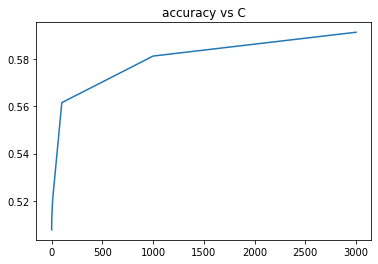

In [300]:
## dont run if model is loaded!
plt.plot([0.1, 1, 10, 100, 1000, 3000], acc)
plt.title("accuracy vs C")
plt.show()


best c = 3000 

train on train + validation

In [104]:
## dont run if model is loaded!
svm = SVC(C = 3000, kernel = "rbf")
svm.fit(X_CV,Y_CV)

SVC(C=3000)

check generalisation

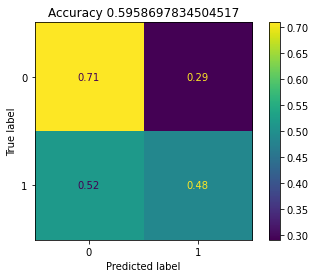

In [105]:
acc_svm = accuracy_score(Y_test, svm.predict(X_test))
plot_confusion_matrix(svm,X_test,Y_test, normalize = "true")
plt.title(f"Accuracy {acc_svm}")
plt.show()

In [106]:
## lets save it 

filename = 'svm_wo_preproc.sav'
pickle.dump(svm, open(filename, 'wb'))

## Ensemble: gradient boosting classifier

parameters for tuning 

In [306]:
param_grid = {'min_impurity_decrease': [0, 0.1, 0.4, 0.6, 0.9], 'n_estimators': [100,300,800,1000,1500]}

check accuracy 

In [ ]:
## dont run if model is loaded!
acc = []
for i in ParameterGrid(param_grid):
    gr = GradientBoostingClassifier(min_impurity_decrease = i['min_impurity_decrease'], n_estimators = i['n_estimators'] )
    gr.fit(X_train,Y_train)  
    acc_gr = accuracy_score(Y_valid, gr.predict(X_valid))
    acc.append(acc_gr)
    print(acc_gr)

best parameters 

In [314]:
ParameterGrid(param_grid)[acc.index(max(acc))]

{'n_estimators': 1500, 'min_impurity_decrease': 0}

train on train + validation

In [107]:
## dont run if model is loaded!
gradboost = GradientBoostingClassifier(n_estimators = 1500, min_impurity_decrease = 0)
gradboost.fit(X_CV,Y_CV)  

GradientBoostingClassifier(min_impurity_decrease=0, n_estimators=1500)

check model generalisation 

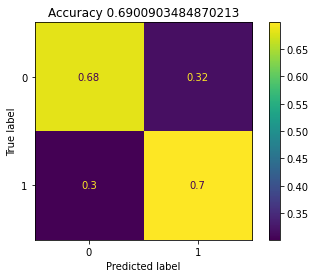

In [108]:
plot_confusion_matrix(gradboost,X_test,Y_test, normalize = "true")
plt.title(f"Accuracy {accuracy_score(Y_test, gradboost.predict(X_test))}")
plt.show()

In [109]:
## lets save it 
filename = 'gradboost_wo_preproc.sav'
pickle.dump(gradboost, open(filename, 'wb'))

## KNN 

tunning 

In [ ]:
## dont run if model is loaded!
acc = []
for i in np.arange(1, 50, 1):
    knn = KNeighborsClassifier(n_neighbors = int(i))
    knn.fit(X_train,Y_train)  
    acc_knn = accuracy_score(Y_valid, knn.predict(X_valid))
    acc.append(acc_knn)
print(acc.index(max(acc))+1)

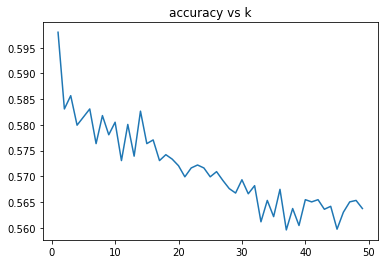

In [324]:
## dont run if model is loaded!
plt.plot(np.arange(1, 50, 1), acc)
plt.title("accuracy vs k")
plt.show()

train on train + validation

In [110]:
## dont run if model is loaded!
## final 
knn = KNeighborsClassifier(n_neighbors = 1)
knn.fit(X_CV,Y_CV)  

KNeighborsClassifier(n_neighbors=1)

check generalisation

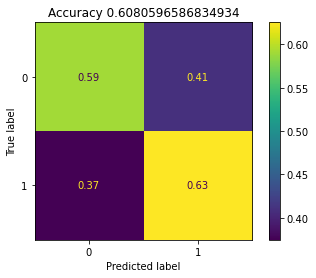

In [111]:
plot_confusion_matrix(knn,X_test,Y_test, normalize = "true")
plt.title(f"Accuracy {accuracy_score(Y_test, knn.predict(X_test))}")
plt.show()

In [112]:
## lets save it 
filename = 'knn_wo_preproc.sav'
pickle.dump(knn, open(filename, 'wb'))

# Final classifier

final classifier will be chosen by accuracy:

In [113]:
classifiers = [logistic, svm, gradboost, knn]
score_dict =  {cls.__class__.__name__: accuracy_score(Y_test, cls.predict(X_test)) for cls in classifiers}
score_dict

{'LogisticRegression': 0.5875519862326115,
 'SVC': 0.5958697834504517,
 'GradientBoostingClassifier': 0.6900903484870213,
 'KNeighborsClassifier': 0.6080596586834934}

as we can see best classifier is Gradient Boosting Classifier

adding assertions:
- Model will take dataframe as an input
- number of features should match with trained 

In [114]:
def assertion_step(x, *args):
    assert isinstance(x,pd.DataFrame), "input is not a dataframe"
    assert x.shape[1] == test_raw.shape[1], "wrong shape"
    return x

input: x = dataframe, y = dataframe of integers or np.array  

In [115]:
final_classifier = Pipeline([("assert", FunctionTransformer(assertion_step)),('preprocess', Preprocessing_pipe), ("classifier", gradboost)])

In [116]:
## lets save it 
filename = 'final_classifier.sav'
pickle.dump(final_classifier, open(filename, 'wb'))

predict test data: 

In [117]:
predictions = pd.DataFrame(final_classifier.predict(test_raw), columns = ["predictions"])
predictions.to_parquet("predictions.parquet")

# Conclusions

Dataset contains 76 features from which 27 are categorical and 36 continuous. Target proportions are not equal. For feature evaluation chi2 and anova tests were conducted. Data analysis shown that most important features are cities, brands, catalog_codes, window_item_sold, total_negative_feadback_count, birthday and phone_verification_local_time. However, on PCA projections no visible decision boundary is visible, making classification task hard.

Few machine learning models were trained: logistic regression, SVM, gradient boosting classifier and KNN. For training  balanced dataset and all features were used, only for categorical features# maximum 10 categories were selected by chi2 test. The accuracies of models are: 

- LogisticRegression L1 = 0.591 
- SVC RBF kernel = 0.594
- gradient boosting classifier = 0.687
- KNN = 0.614

Low accuracy of logistic regression was expected because of the reasons mensioned before. Not surpisingly gradient boosting classifier yielded best score.

It can be said that methodology used in feature selection was not correct as not the features were selected but max 10 best feature categories and all features were used. As some lower score category in one feature could be higher than category with highest score in another feature. Thus model could perform better. 

